## **DS 5110: Big Data Systems | Final Project**
## **State of Virginia Traffic Reliability | MAP21**
## **Code Part 1 | Data Import and Preprocessing**

### by Christian Schroeder (dbn5eu), Timothy Tyree (twt6xy), Colin Warner (ynq9ya)

---

## **Brief Overview**

**Project Description:** This study develops a target setting methodology for the (Moving Ahead for Progress) MAP-21 Interstate Travel Time Reliability Measure of “Percent of the person-miles traveled on the Interstate that are Reliable” (PMTR-IS). The study uses Virginia specific data for a set of independent variables (Number of Lanes, Terrain, Urban Designation, Equivalent Property Damage Only Rate, Lane Impacting Incident Rate, Truck Percentage, Presence of Safety Service Patrol, Hourly Volume, and Volume/Capacity Ratio) to predict if a MAP-21 reporting segment is reliable. This is used to estimate Predicted PMTR-IS with the MAP-21 specified formula. This is an ongoing project at the Virginia Department of Transportation (VDOT) and they have asked our team to explore more-advanced classification models. They previously went through 1,563 different configurations of Classification and Regression Tree (CART) models. VDOT provided us with all of the raw data - 12 csv files that need extensive preprocessing before a final dataset can analyzed. The data consists of the metrics listed above for each year between 2017 and 2020, for each highway segment in Virginia. Furthermore, VDOT forecasted their metrics out to 2024. Our goal is to use the actual data up to 2020 to find an accurate model using train, test, and validation splits. If that model is found, we can use the forecasted metrics to classify *future* unreliable segments.

**What is MAP-21?** "MAP-21, the Moving Ahead for Progress in the 21st Century Act (P.L. 112-141), was signed into law by President Obama on July 6, 2012. Funding surface transportation programs at over \\$105 billion for fiscal years (FY) 2013 and 2014, MAP-21 is the first long-term highway authorization enacted since 2005. MAP-21 is a milestone for the U.S. economy and the Nation’s surface transportation program. By transforming the policy and programmatic framework for investments to guide the system’s growth and development, MAP-21 creates a streamlined and performance-based surface transportation program and builds on many of the highway, transit, bike, and pedestrian programs and policies established in 1991." Source: https://www.fhwa.dot.gov/map21/


**Notebook Description:** In this particular Notebook, we will walk through (1) the importing of our data from the Virginia Department of Transportation, and (2) the necessary preprocessing of our data to ensure our data is in a format that is reliable for Splitting, Exploratory Analysis, and Modeling. To avoid lines of repetitive code (reading, joining, etc.) we wrote a custom preprocessing class. The following section imports said class and explains how it works.

---

## **Import Packages, Initialize Spark Session, Read, Combine, and Transform Data to a Workable Format**

Below we call the readAndCombineData() function from the Preprocessor class to perform the following tasks;
1. Create a dictionary of directories with the directory name as key (ex. TMC/) and empty lists as values. This will hold dataframes that can be joined on shared unique identifiers.
2. Gets the full path to the input directories and uses a formatted string to get get the other directories in a loop. (looping through the directory name keys)
3. Creates a nested list of lists that define the type of joins each directory will be performing. Ordered the same as the directories.
4. Joins all data as follows;
    - a) Outer loop through each directory
    - b) Inner loop through the files in each directory and read the file into a Spark dataframe.
    - c) Append the dataframe to the values list within its respective directory (key/outer loop)
    - d) Get out of the inner loop, pop the last data frame out of this list, and save it to a temporary variable. This will be the df that starts joining on each directories respective join identifiers.
    - e) Join dataframes within each directory into one. Results in 3 dataframes after starting with 12. The logic is similar to sorting algorithms. Within another inner loop Start with the dataframe that was popped, set a temp df as that df, create a joined df with the temp df and the current loops df, on the columns specified within the current iterations index location of the join list, then set the temp df as the joined df, and set the start df back to temp. This will successfully join each dataframe within the list on their respective identifiers without repeating or missing dataframes. 
    - f) Outside the previous loop, append the start df (which is now the full joined df) to the end of the list, and drop every other df in the list. 
    - g) As a sanity check, loop through all columns in the joined df and drop any that may be duplicate.
5. Sequentially join the final three dfs into one, making sure to join on the df that had more previous identifiers so there's no data loss. 
6. Create trainable and forecasted datasets by filtering on year (trainable < 2021), (forecasted > 2020)
7. Save the data.

Throughout the process, markdown formatted print statements are output to aid in debugging, and knowing what the function is currently doing.

In [1]:
from Helpers.Preprocessor_Class import Preprocessor
preprocessor = Preprocessor()
actualData, forecastedData = preprocessor.readAndCombineData()

### Listing All Tables in the TMC Directory

urban_rural.csv
county_district.csv
TMC_metadata.csv
terrain.csv
[DataFrame[TMC: string, AREATYPE: string],
 DataFrame[TMC: string, County: string, District: string],
 DataFrame[TMC: string, ROAD: string, DIR: string, ROAD_DIR: string, INTERSECTION: string, ROAD_ORDER: string, GLOBAL_ORDER: string],
 DataFrame[TMC: string, TERRAIN: string]]


### Joining All Tables by the TMC Identifier

#### The dataset has 11 columns and 1707 rows

DataFrame[TMC: string, TERRAIN: string, AREATYPE: string, County: string, District: string, ROAD: string, DIR: string, ROAD_DIR: string, INTERSECTION: string, ROAD_ORDER: string, GLOBAL_ORDER: string]


---

### Listing All Tables in the TMC_YEAR Directory

num_lanes.csv
[DataFrame[TMC: string, YEAR: string, lanes: string]]


### Joining All Tables by the TMC_YEAR Identifier

#### The dataset has 3 columns and 13656 rows

DataFrame[TMC: string, YEAR: string, lanes: string]


---

### Listing All Tables in the TMC_YEAR_PERIOD Directory

vol_v_over_c.csv
precip.csv
pct_duration_weather_events.csv
SSP.csv
crashes.csv
[DataFrame[TMC: string, YEAR: string, PERIOD: string, V/C_STRAIGHT_AVG: string, AVG_HOURLY_VAL: string],
 DataFrame[TMC: string, YEAR: string, PERIOD: string, PCT-PRECIP-MINS: string],
 DataFrame[TMC: string, YEAR: string, PERIOD: string, ALL_WEATHER: string],
 DataFrame[TMC: string, YEAR: string, PERIOD: string, SSP: string],
 DataFrame[TMC: string, YEAR: string, PERIOD: string, Crashes: string]]


### Joining All Tables by the TMC_YEAR_PERIOD Identifier

#### The dataset has 9 columns and 54624 rows

DataFrame[TMC: string, YEAR: string, PERIOD: string, Crashes: string, V/C_STRAIGHT_AVG: string, AVG_HOURLY_VAL: string, PCT-PRECIP-MINS: string, ALL_WEATHER: string, SSP: string]


---

### Combing a Final Table

#### The dataset has 21 columns and 54624 rows

---

### Separating the actual and trainable data from the forecasted data

+---------+------+----+-------+----------------+--------------+---------------+-----------+---+-----+-------+---------+-------------+-----------------+-----+---+--------+--------------------+----------+------------+----------+
|      TMC|PERIOD|YEAR|Crashes|V/C_STRAIGHT_AVG|AVG_HOURLY_VAL|PCT-PRECIP-MINS|ALL_WEATHER|SSP|lanes|TERRAIN| AREATYPE|       County|         District| ROAD|DIR|ROAD_DIR|        INTERSECTION|ROAD_ORDER|GLOBAL_ORDER| TRUCK_PCT|
+---------+------+----+-------+----------------+--------------+---------------+-----------+---+-----+-------+---------+-------------+-----------------+-----+---+--------+--------------------+----------+------------+----------+
|110+04170|   AMP|2018|      0|     0.705245209|       3133.25|         0.0035|0.014800713|  Y|    2|  Level|Urbanized|    ARLINGTON|Northern Virginia| I-66| WB| I-66 WB|US-29/VA-237/EXIT 69|        18|         923| 1.5585342|
|110+04170|  MIDD|2018|      0|     0.654287596|        2921.5|         0.0021|  0.0070138| 

#### The trainable dataset has 22 columns and 27312 rows

---

## **Exploratory Data Analysis**

Visualize data to view distributions and understand how certain variables contribute to highway segment reliability. We will use Python in this section due to Spark having limited visualization services, and using Jupyter Notebooks (opposed to Apache Zeppelin which would allow us to continue using Spark). The following cell loads the trainable data into a pandas dataframe, and instantiates the Visualizer helper class we made.

In [2]:
from Helpers.Visualizer_Class import Visualizer
import pandas as pd
trainableData = pd.read_csv("Data/Final_Data/trainableData.csv")
visualizer = Visualizer(trainableData)
trainableData.head()

,Unnamed: 0,TMC,YEAR,PERIOD,Crashes,V/C_STRAIGHT_AVG,AVG_HOURLY_VAL,PCT-PRECIP-MINS,ALL_WEATHER,SSP,...,County,District,ROAD,DIR,ROAD_DIR,INTERSECTION,ROAD_ORDER,GLOBAL_ORDER,TRUCK_PCT,obs rel_unrel
0,0,110+04121,2017,AMP,24,0.804676,5248.250000,0.0001,0.066037,Y,...,FAIRFAX,Northern Virginia,I-395,NB,I-395 NB,EDSALL RD/EXIT 2,1.0,221,2.470093,Unrel
1,1,110+04121,2017,MIDD,23,0.705454,4601.333333,0.0043,0.060453,Y,...,FAIRFAX,Northern Virginia,I-395,NB,I-395 NB,EDSALL RD/EXIT 2,1.0,221,2.470093,Unrel
2,2,110+04121,2017,PMP,23,0.860401,5611.750000,0.0073,0.095791,Y,...,FAIRFAX,Northern Virginia,I-395,NB,I-395 NB,EDSALL RD/EXIT 2,1.0,221,2.470093,Unrel
3,3,110+04121,2017,WE,12,0.778074,5074.857143,0.0025,0.066037,Y,...,FAIRFAX,Northern Virginia,I-395,NB,I-395 NB,EDSALL RD/EXIT 2,1.0,221,2.470093,Unrel
4,4,110+04121,2018,AMP,26,0.781408,5096.750000,0.0035,0.056778,Y,...,FAIRFAX,Northern Virginia,I-395,NB,I-395 NB,EDSALL RD/EXIT 2,1.0,221,2.470093,Unrel


### **What is the distribution of the numerical variables**?

* Exploring the distributions will provide insight into whether certain columns need to be transformed.

/home/wtyree/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:358: RuntimeWarning:

divide by zero encountered in log



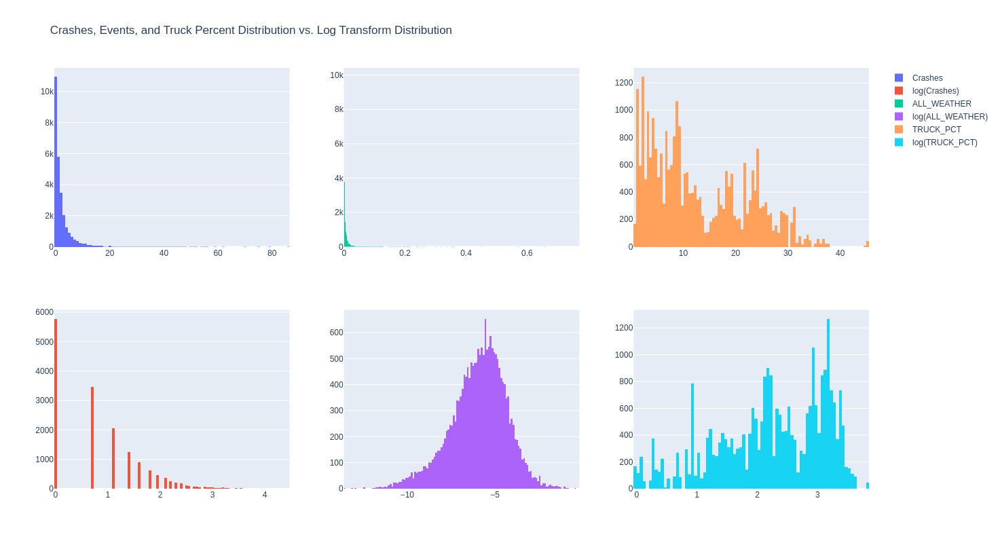

In [3]:
cols, title = ["Crashes","ALL_WEATHER","TRUCK_PCT"], "Crashes, Events, and Truck Percent Distribution vs. Log Transform Distribution"
visualizer.makeHistSubplots(cols, title)

* The weather events column should be log transformed.

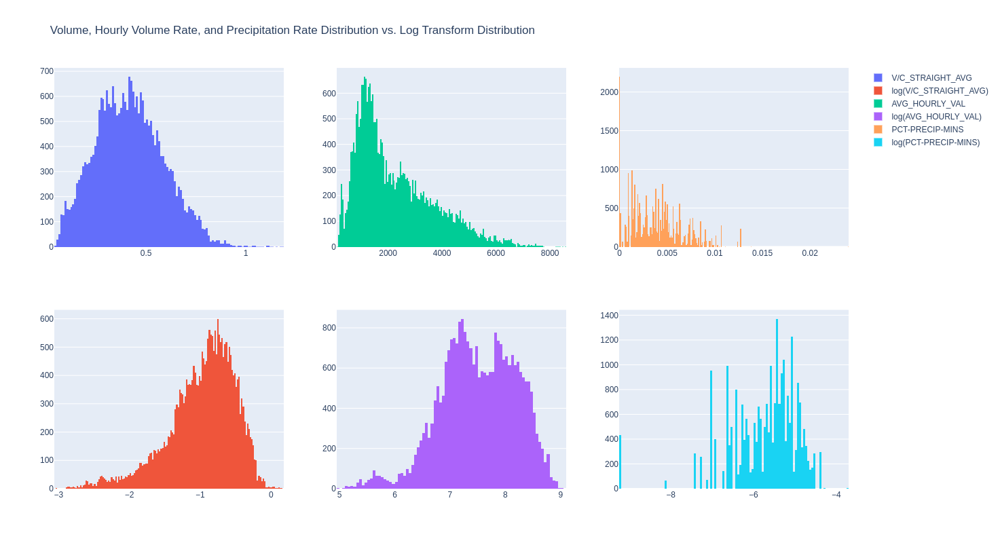

In [4]:
cols = ["V/C_STRAIGHT_AVG", "AVG_HOURLY_VAL", "PCT-PRECIP-MINS"]
title= "Volume, Hourly Volume Rate, and Precipitation Rate Distribution vs. Log Transform Distribution"
visualizer.makeHistSubplots(cols, title)

* The hourly volume and precipitation columns may benefit from a log transform.

### **Exploring how categorical variables affect reliability**

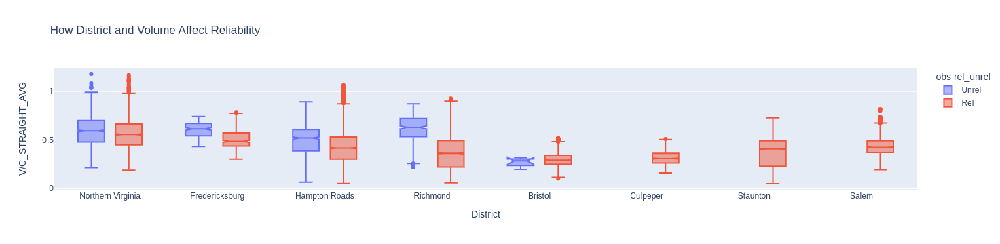

In [5]:
visualizer.makeCatBoxPlots("District", "V/C_STRAIGHT_AVG", "How District and Volume Affect Reliability")

* Culpepper, Staunton, and Salem have no unreliable instances, so we might want to take them out of the dataset.

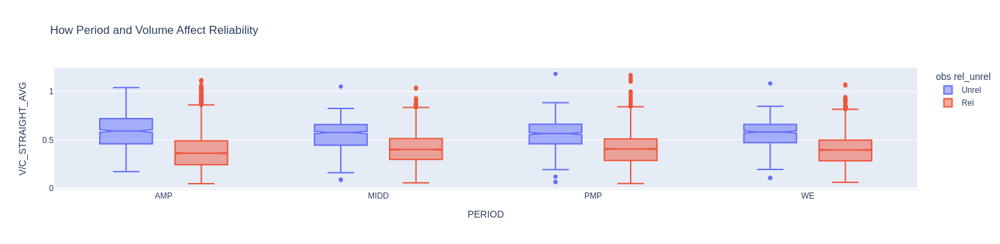

In [6]:
visualizer.makeCatBoxPlots("PERIOD", "V/C_STRAIGHT_AVG", "How Period and Volume Affect Reliability")

* As expected, the AM Peak and the PM Peak (rush hour times) have more unreliable instances.

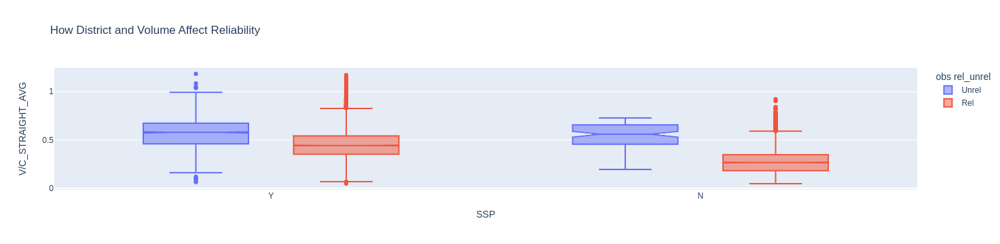

In [7]:
visualizer.makeCatBoxPlots("SSP", "V/C_STRAIGHT_AVG", "How District and Volume Affect Reliability")

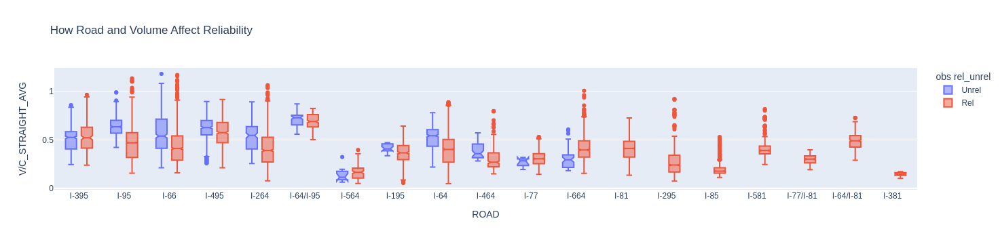

In [8]:
visualizer.makeCatBoxPlots("ROAD", "V/C_STRAIGHT_AVG", "How Road and Volume Affect Reliability")

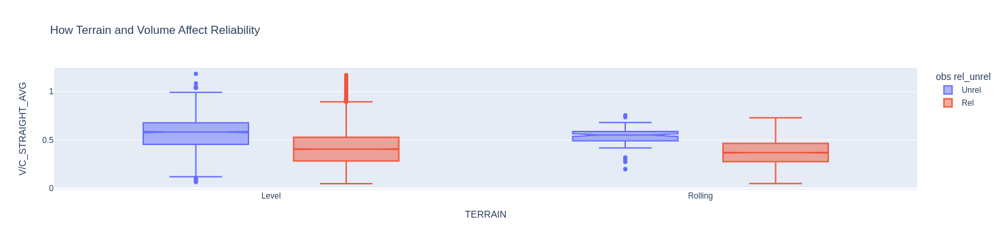

In [9]:
visualizer.makeCatBoxPlots("TERRAIN", "V/C_STRAIGHT_AVG", "How Terrain and Volume Affect Reliability")

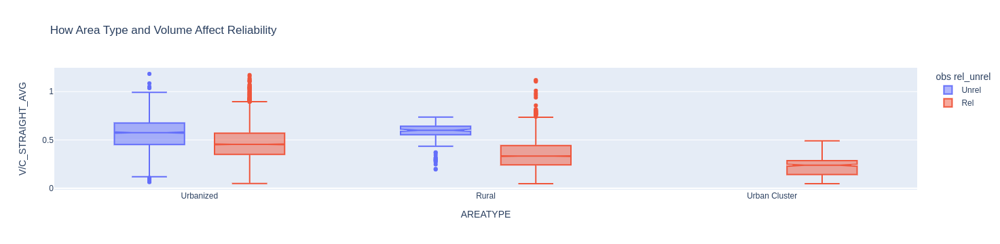

In [10]:
visualizer.makeCatBoxPlots("AREATYPE", "V/C_STRAIGHT_AVG", "How Area Type and Volume Affect Reliability")

### **Map of Highway Segment Reliability**

Christian: Could you look into changing this maps code to where it supports dropdown menus of period and year. It'd be nice to have that functionality.

In [11]:
from Helpers.Mapper_Class import Mapper
mapper = Mapper()
mapAMP2017 = mapper.makePeriodByYearMap('AMP', 2017)
mapAMP2017

/home/wtyree/MSDS/Fall 2022/Big Data Systems/Project/DS5110_MAP21


## Perform Transformations

* We should consider removing some of the instances that don't have unreliable segments.

## Split Data into Train and Test Sets

Randomly split data into 90% training and 10% testing sets.

### Read Data back into Spark Dataframe

In [12]:
train, test = preprocessor.splitData(actualData)